## Библиотеки работы с изображениями на Python

In [15]:
fname = "../../../data/datingscout-u7nxI32spEk-unsplash.jpg"

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

## PIL

Наиболее часто используемая библиотека для работы с изображениями. Существует в двух вариантах:
* Классический "старый" вариант PIL для Python 2
* Современный вариант PIL - Pillow (`pip install Pillow`)

Вот как открыть изображение из файла на диске:

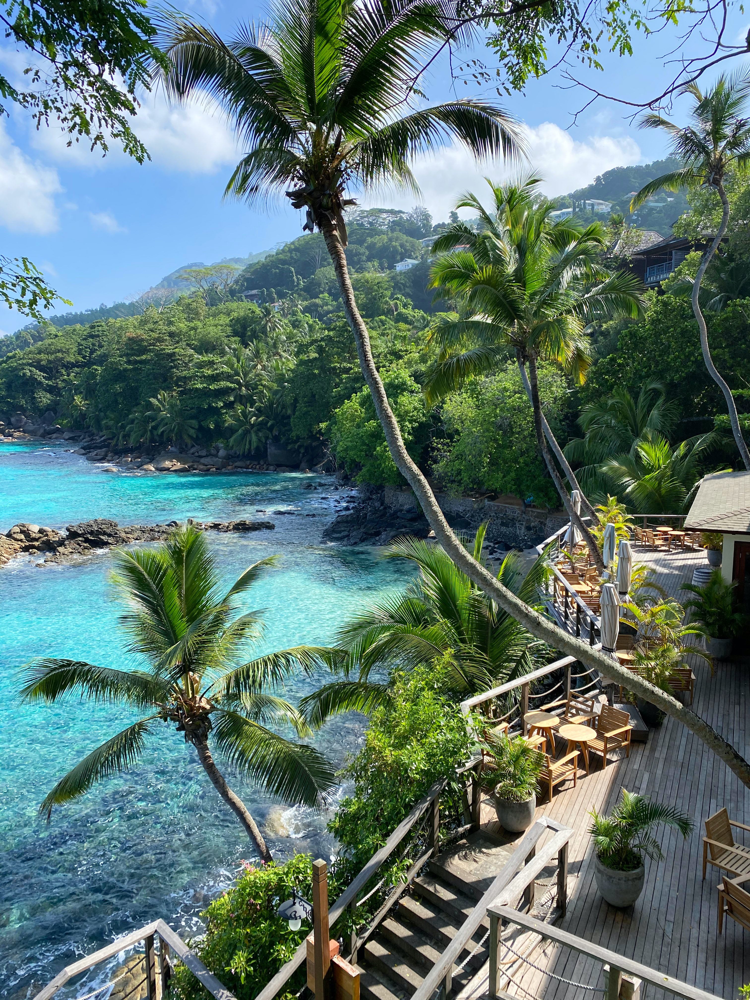

In [16]:
from PIL import Image

img = Image.open(fname)
img

Считанный объект имеет внутренний тип из пространства имён PIL

In [17]:
type(img)

PIL.JpegImagePlugin.JpegImageFile

PIL поддерживает ряд функций для манипуляций с изображением, в т.ч. масштабирование. Чтобы в дальнейшем работать с изображением попиксельно, мы можем преобразовать его в массив numpy:

In [18]:
img = img.resize((480,640),Image.LANCZOS)
im = np.array(img)
im.shape

(640, 480, 3)

Массивы numpy можно отображать в виде картинок с помощью функции `imshow` из matplotlib:

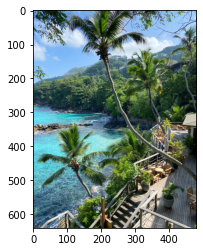

In [19]:
plt.imshow(im)

In [20]:
im

array([[[ 56,  98,  34],
        [ 75, 119,  55],
        [ 69, 119,  12],
        ...,
        [161, 209, 255],
        [160, 208, 254],
        [160, 208, 254]],

       [[ 57, 107,  81],
        [ 69, 115,  57],
        [ 73, 123,  41],
        ...,
        [161, 209, 255],
        [161, 209, 255],
        [160, 208, 254]],

       [[106, 166, 224],
        [ 75, 127, 126],
        [ 78, 128, 122],
        ...,
        [160, 208, 253],
        [161, 208, 254],
        [159, 207, 253]],

       ...,

       [[ 28,  61,  86],
        [ 49,  77, 100],
        [ 48,  76, 101],
        ...,
        [ 97, 106,  69],
        [161, 180,  73],
        [ 98, 104,  57]],

       [[ 25,  58,  82],
        [ 34,  63,  85],
        [ 47,  75,  97],
        ...,
        [104, 112,  70],
        [153, 173,  48],
        [114, 119,  52]],

       [[ 40,  74,  92],
        [ 49,  78,  94],
        [ 52,  83, 101],
        ...,
        [124, 133,  73],
        [166, 181,  47],
        [205, 208, 137]]

С помощью функций numpy мы можем совершать ряд манипуляций с изображениями, например, увеличить яркость:

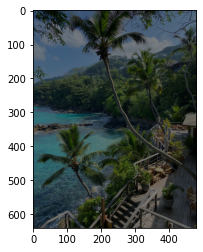

In [27]:
im1 = (np.clip(im.astype(np.float32)/255*1.5,0,1)*255).astype(np.uint8)
plt.imshow(im1)


Для превращения массива numpy обратно в PIL-изображение, используем функцию `fromarray`:

In [25]:
Image.fromarray(im).save("demo.jpg")

Построим также гистограмму распределения яркости цветов по каждому из каналов:

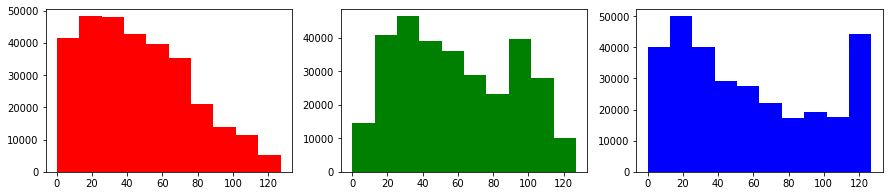

In [28]:
fig,ax = plt.subplots(1,3,figsize=(15,3))
for i in range(3):
    ax[i].hist(im1[:,:,i].reshape(-1),color=['r','g','b'][i])

## Imageio

Библиотека `imageio` содержит богатые функции для считывания и записи изображений и видео в различных форматах. В том числе, можно считывать анимированные gif-изображения и видео непосредственно из интернет:

In [1]:
import imageio.v3 as iio
img = iio.imread("https://media.giphy.com/media/11dR2hEgtN5KoM/giphy.gif")
img.shape

(19, 480, 460, 3)

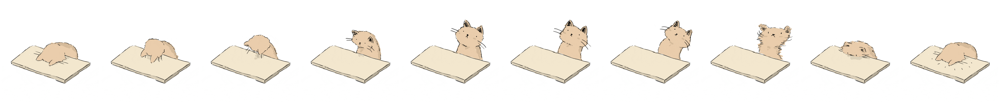

In [30]:
def display_images(l):
    n=len(l)
    fig,ax = plt.subplots(1,n)
    for i,im in enumerate(l):
        ax[i].imshow(im)
        ax[i].axis('off')
    fig.set_size_inches(fig.get_size_inches()*n)
    plt.tight_layout()
    plt.show()

display_images(img[::2])

## OpenCV

OpenCV - это мощная библиотека, реализованная на C++. Её можно использовать из Python с помощью соответствующего API. Мы подробнее познакомимся с OpenCV в следующем разделе.

In [31]:
import cv2
img = cv2.imread(fname)
img.shape

(4032, 3024, 3)

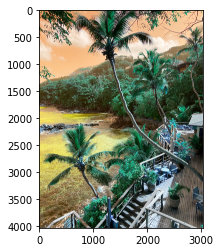

In [32]:
plt.imshow(img)

OpenCV по умолчанию хранит изображения в формате **BGR**, а не **RGB** - т.е. порядок цветовых каналов различается. Чтобы преобразовать изображение к RGB, используем соответствующую функцию:

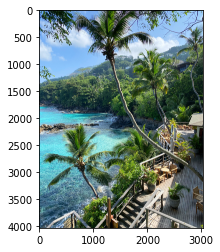

In [33]:
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(img)

В OpenCV очень много полезных функций обработки изображений. В т.ч. масштабирование:

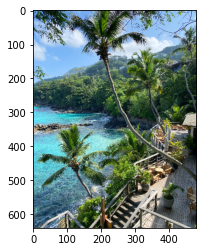

In [34]:
im = cv2.resize(img,(480,640))
plt.imshow(im)

Можно преобразовать изображение к другому **пространству цветов**. В данном случае мы переводим изображение в формат HSV: Hue-Saturatuion-Value. Посмотрим, какой эффект имеет сдвиг по каналу Hue:

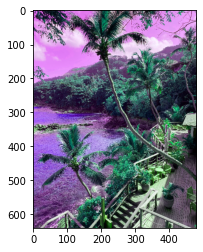

In [35]:
i = cv2.cvtColor(im,cv2.COLOR_RGB2HSV)
i[:,:,0] = (i[:,:,0]+40)%255
plt.imshow(cv2.cvtColor(i,cv2.COLOR_HSV2RGB))

Мы можем записать видео, показывающее плавное изменение цветовой гаммы:

In [36]:
out = cv2.VideoWriter('output.avi', cv2.VideoWriter_fourcc(*"ffds"), 30, (480,640))
i = cv2.cvtColor(im,cv2.COLOR_RGB2HSV)
for _ in range(255):
    i[:,:,0] = (i[:,:,0]+1)%255
    out.write(cv2.cvtColor(i,cv2.COLOR_HSV2BGR))
out.release()